In [ ]:
import numpy as np
import scanpy as sc
import matplotlib.pyplot as plt
from numpy.random import default_rng
import squidpy as sq
import pandas as pd
import anndata as ad
from pathlib import Path
from jax.config import config
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from joblib import delayed, Parallel
from anndata import AnnData
import mplscience
from tqdm import tqdm
import os
import seml

mplscience.set_style()

config.update("jax_enable_x64", True)
# # sc.set_figure_params()
%load_ext autoreload
%autoreload 2
%load_ext lab_black

In [ ]:
results = seml.get_results("sink_brain", to_data_frame=True)
results

In [ ]:
root = Path("/lustre/groups/ml01/workspace/moscot_paper/benchmarks/space/sink_brain")
# adata = sc.read(root / "159bec2f7e8a663fa744956848204f80_0.2_1")

In [ ]:
files = [i for i in os.listdir(root) if "sink.h5ad" in i]
files

['6934046d60b445950efd2d611af3cf21_sink.h5ad',
 '3e50df6ca49e33352e213a3ecd801f00_sink.h5ad',
 'fdd1958ee70c11a517b3547b044d8796_sink.h5ad',
 'e8ce51e1641a8a25f8548d99ec75c93f_sink.h5ad']

6934046d60b445950efd2d611af3cf21_sink.h5ad


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


3e50df6ca49e33352e213a3ecd801f00_sink.h5ad


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


fdd1958ee70c11a517b3547b044d8796_sink.h5ad


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


e8ce51e1641a8a25f8548d99ec75c93f_sink.h5ad


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


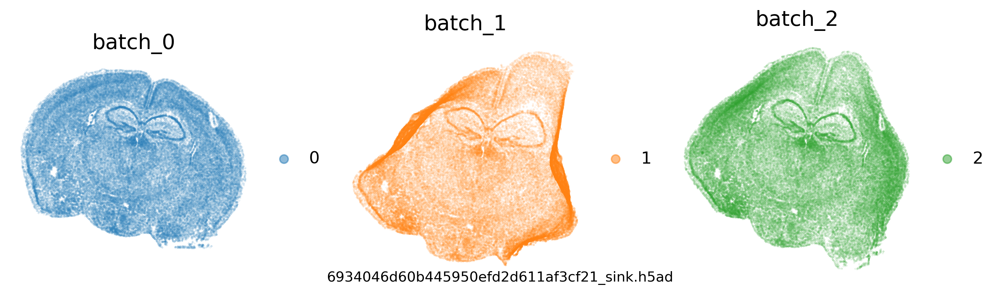

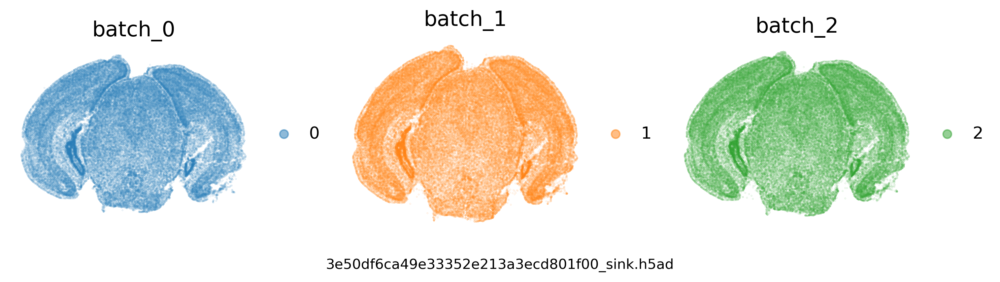

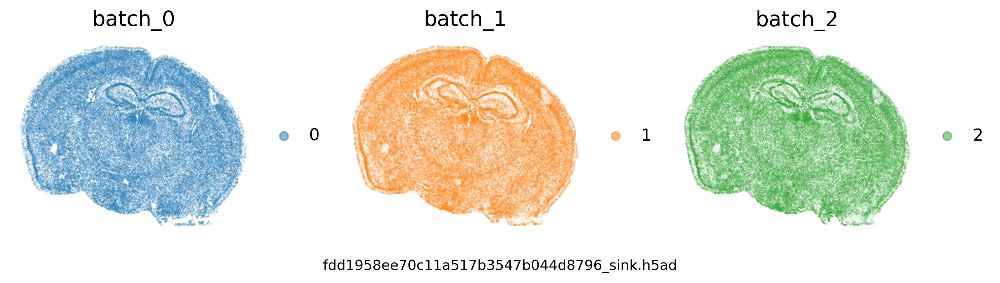

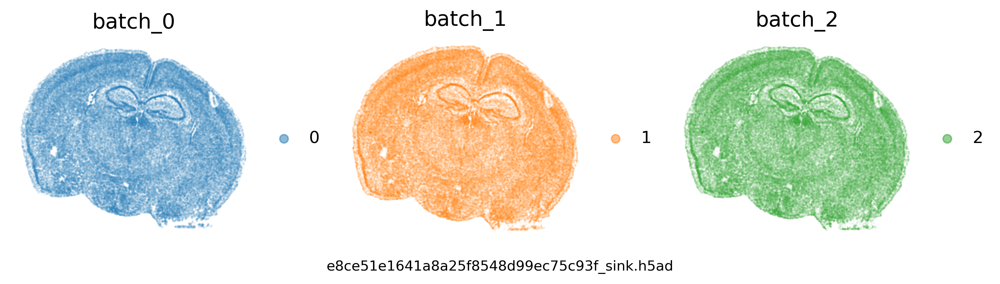

In [6]:
plt.rcParams["legend.scatterpoints"] = 1
for f in files:
    adata = sc.read(root / f)
    fig, ax = plt.subplots(1, 3, figsize=(10, 3), dpi=300)
    print(f)
    for i, a in enumerate(ax):
        sq.pl.spatial_scatter(
            adata,
            spatial_key="spatial_norm_final",
            shape=None,
            color="batch_final",
            groups=[f"{i}"],
            frameon=False,
            title=[f"batch_{i}"],
            size=0.01,
            alpha=0.5,
            fig=fig,
            ax=a,
        )
    fig.text(0.5, 0.05, f, ha="center")
    plt.tight_layout()

In [21]:
adata = sc.read(root / "e8ce51e1641a8a25f8548d99ec75c93f_sink.h5ad")

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


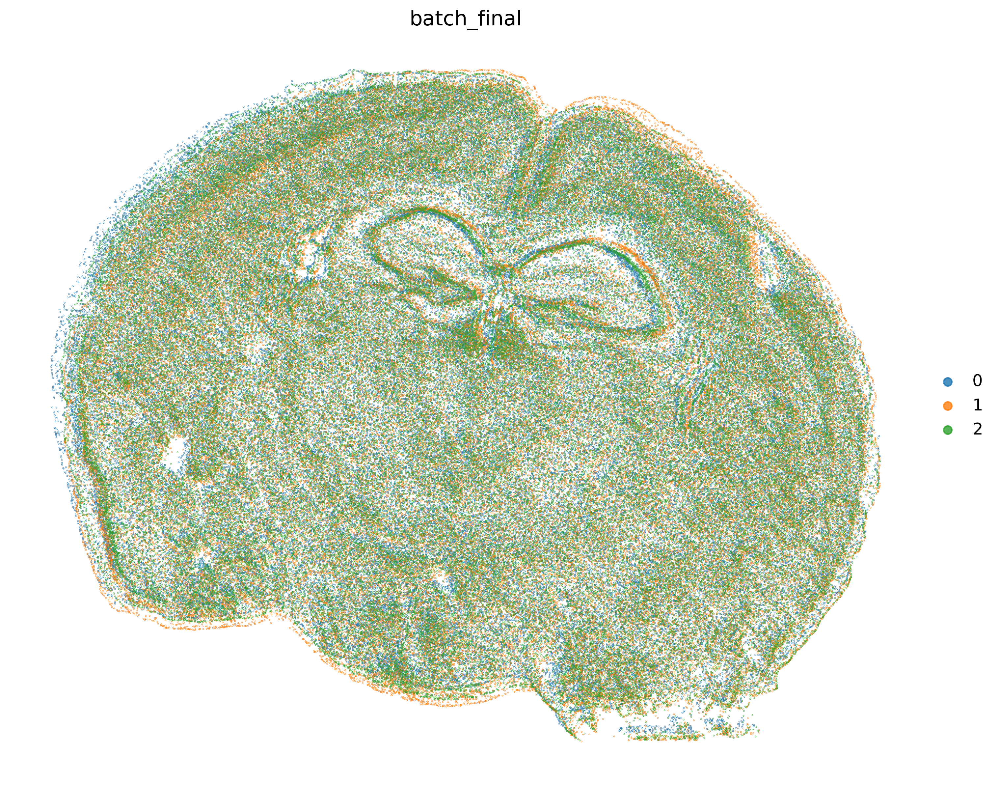

In [22]:
sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_norm_final",
    shape=None,
    color="batch_final",
    frameon=False,
    size=0.1,
    alpha=0.8,
    figsize=(10, 10),
    dpi=300,
)

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


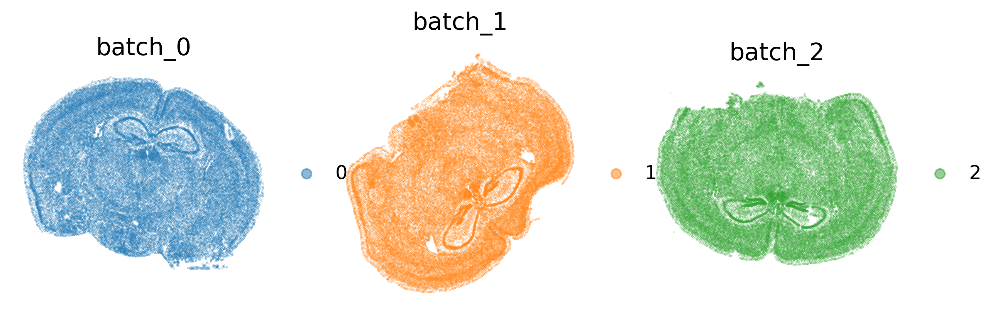

In [23]:
fig, ax = plt.subplots(1, 3, figsize=(10, 3), dpi=300)
for i, a in enumerate(ax):
    sq.pl.spatial_scatter(
        adata,
        spatial_key="spatial_norm",
        shape=None,
        color="batch_final",
        groups=[f"{i}"],
        frameon=False,
        title=[f"batch_{i}"],
        size=0.01,
        alpha=0.5,
        fig=fig,
        ax=a,
    )

In [16]:
adata = sc.read(root / "3e50df6ca49e33352e213a3ecd801f00_sink.h5ad")

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


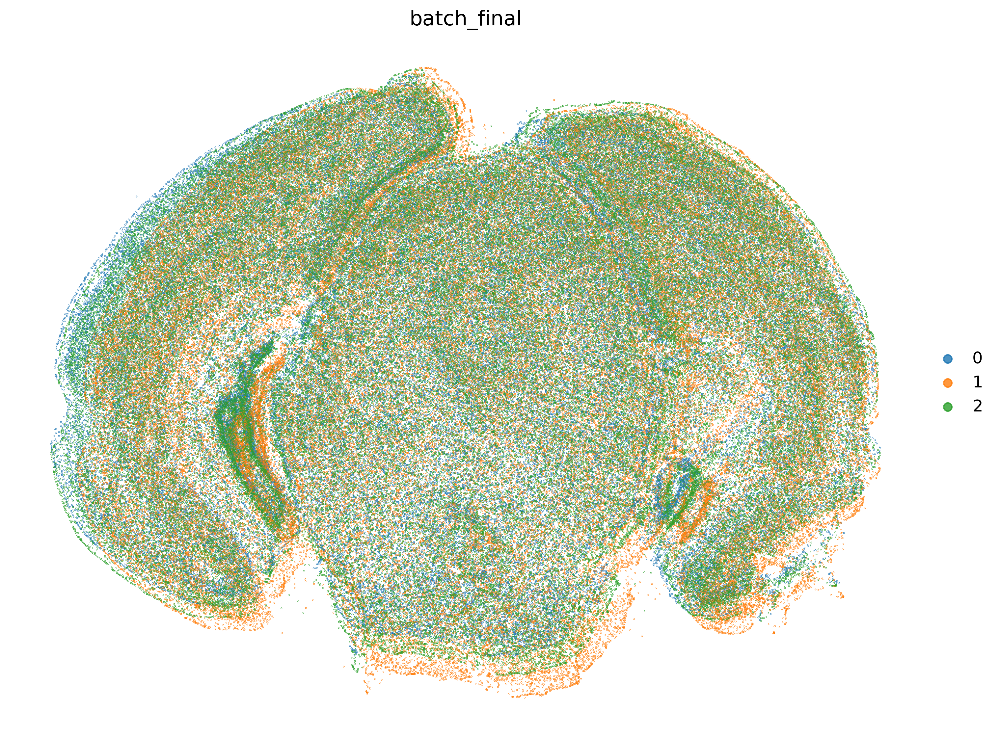

In [17]:
sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_norm_final",
    shape=None,
    color="batch_final",
    frameon=False,
    size=0.1,
    alpha=0.8,
    figsize=(10, 10),
    dpi=300,
)

In [18]:
# from moscot.problems.generic import SinkhornProblem

# sp = SinkhornProblem.load(
#     "/lustre/groups/ml01/workspace/moscot_paper/benchmarks/space/sink_brain/e8ce51e1641a8a25f8548d99ec75c93f_1_0.0001_SinkhornProblem.pkl"
# )

In [ ]:
sp[("0", "1")].solution.plot_errors()

In [ ]:
sp[('0', '1')].solution.plot_costs()